In [1]:
import pandas as pd
import langdetect
from matplotlib import pyplot as plt
import tqdm

import umap
from top2vec import Top2Vec

%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Standard plotly imports
import chart_studio.plotly as py 
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
# Using plotly + cufflinks in offline mode
import cufflinks
cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)

In [4]:
#read data here
fn = 'example_data/Arxiv_sample/Arxiv_Nodes_Paper.jsonl'
df = pd.read_json(fn, lines=True)

In [6]:
text_col = 'abstract'

#use for multilingual
embed_model = 'universal-sentence-encoder-multilingual'
#use for english
embed_model = 'universal-sentence-encoder'

model = Top2Vec(list(df[text_col].values), 
                embedding_model=embed_model)

2021-06-14 19:25:37,019 - top2vec - INFO - Pre-processing documents for training
INFO:top2vec:Pre-processing documents for training
2021-06-14 19:26:06,326 - top2vec - INFO - Downloading universal-sentence-encoder model
INFO:top2vec:Downloading universal-sentence-encoder model
INFO:absl:Downloading TF-Hub Module 'https://tfhub.dev/google/universal-sentence-encoder/4'.
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 180.00MB
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 360.00MB
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 520.00MB
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 670.00MB
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 810.00MB
INFO:absl:Downloading https://tfhub.dev/google/universal-sentence-encoder/4: 970.00MB
INFO:absl:Downloaded https://tfhub.dev/google/universal-sentence-encoder/4, Total size: 987.47MB
INFO:absl:Downlo

In [7]:
model.get_num_topics()

86

In [8]:
topic_sizes, topic_nums = model.get_topic_sizes()
for t,topic in enumerate(topic_nums):
    print(topic,topic_sizes[t])
    documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic,
                                                                               num_docs=topic_sizes[t])
    df.loc[document_ids,'topic'] = topic

0 3833
1 2308
2 2181
3 1994
4 1340
5 1232
6 1167
7 857
8 846
9 817
10 786
11 760
12 737
13 723
14 670
15 666
16 582
17 565
18 550
19 494
20 491
21 478
22 472
23 443
24 428
25 421
26 409
27 390
28 380
29 361
30 358
31 342
32 339
33 323
34 303
35 303
36 300
37 286
38 278
39 261
40 250
41 249
42 247
43 246
44 246
45 243
46 236
47 235
48 235
49 227
50 220
51 211
52 187
53 175
54 172
55 167
56 166
57 156
58 147
59 136
60 134
61 129
62 125
63 124
64 123
65 116
66 115
67 115
68 113
69 105
70 97
71 96
72 94
73 92
74 91
75 90
76 88
77 86
78 85
79 82
80 72
81 67
82 66
83 61
84 54
85 48


In [11]:
model.save("name_of_model")
df.to_csv("data_with_topics.csv",index=False)

In [12]:
topic_words, word_scores, topic_nums = model.get_topics()
topic_words

array([['dirac', 'wavefunction', 'invariance', ..., 'waveforms',
        'photons', 'massless'],
       ['mev', 'dirac', 'arxiv', ..., 'physicists', 'graviton',
        'positron'],
       ['dirac', 'lagrangian', 'invariance', ..., 'hermitian', 'tensor',
        'neutrinos'],
       ...,
       ['psi_', 'psi', 'arxiv', ..., 'physics', 'antimatter',
        'entanglement'],
       ['asteroids', 'asteroid', 'colliding', ..., 'neutrino', 'jupiter',
        'graviton'],
       ['polymers', 'polymer', 'arxiv', ..., 'conformal', 'conductance',
        'feynman']], dtype='<U15')

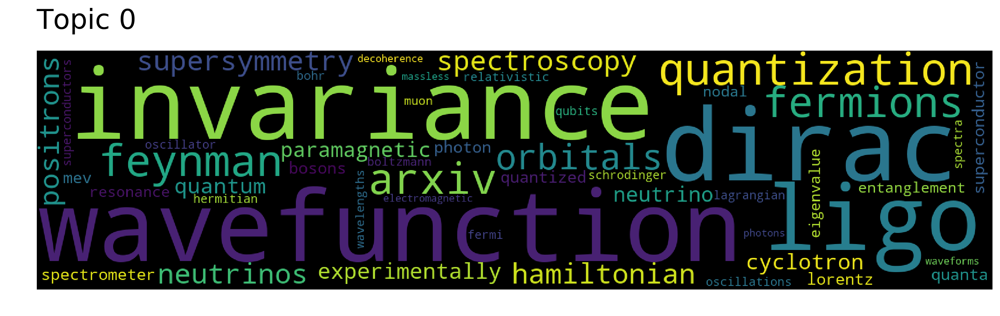

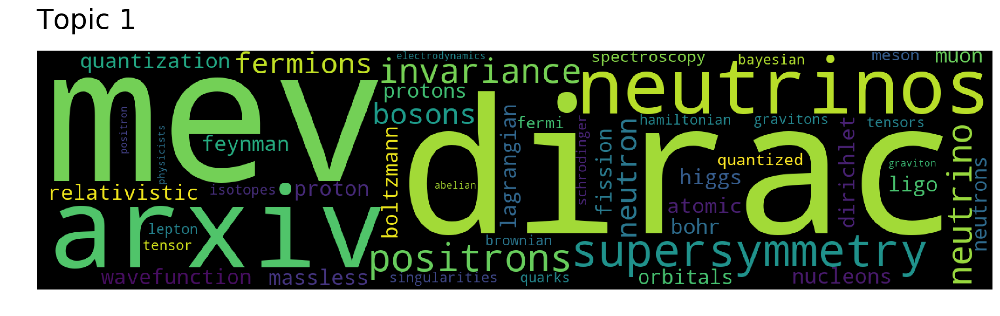

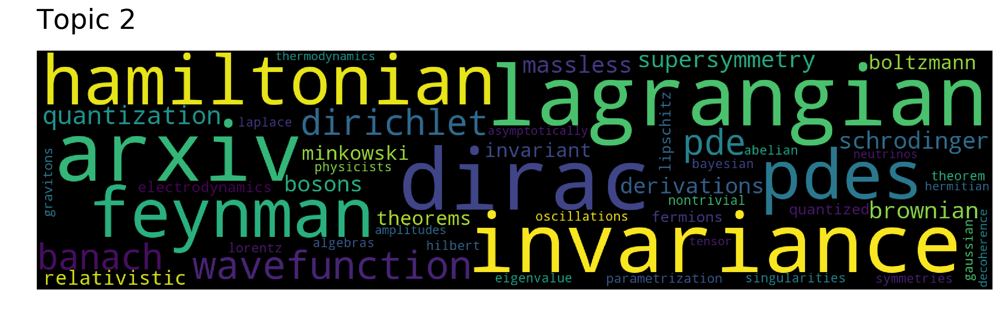

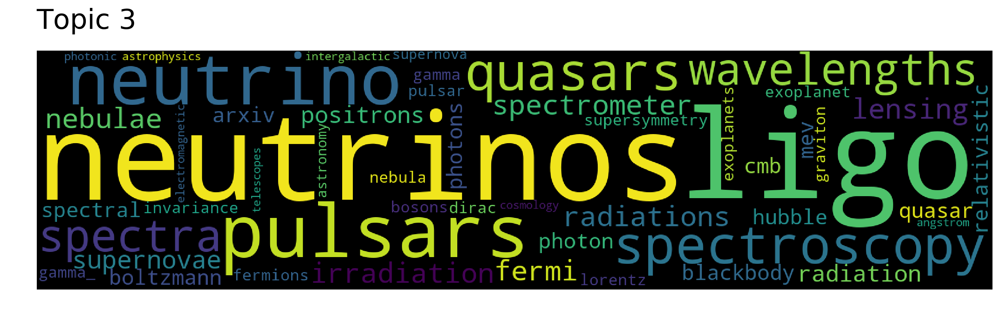

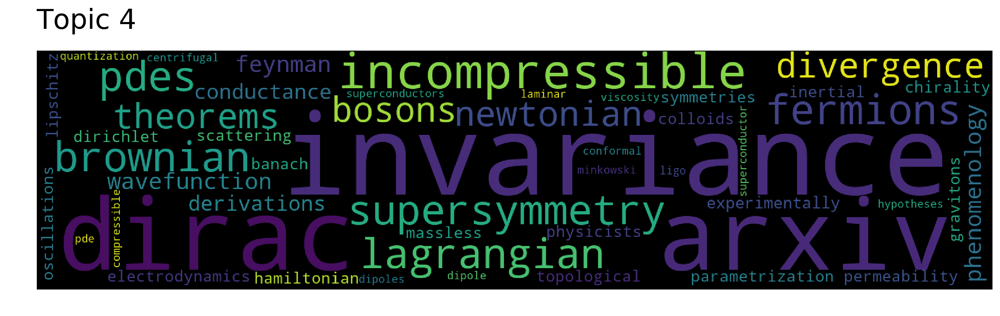

...

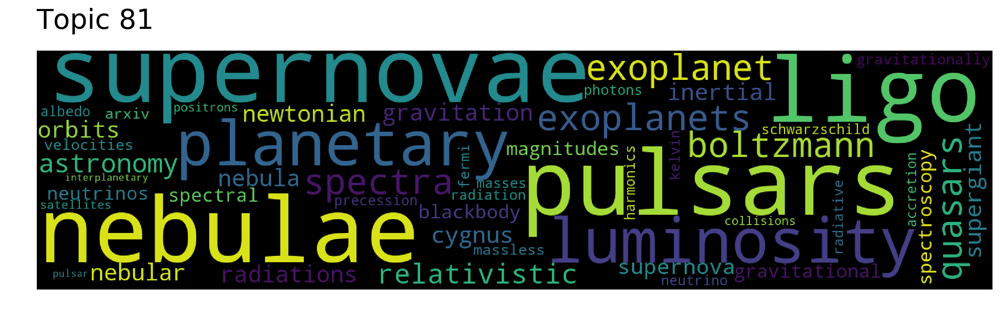

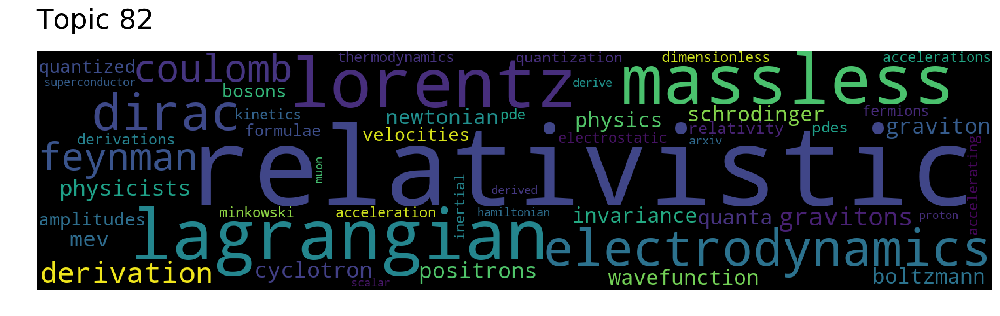

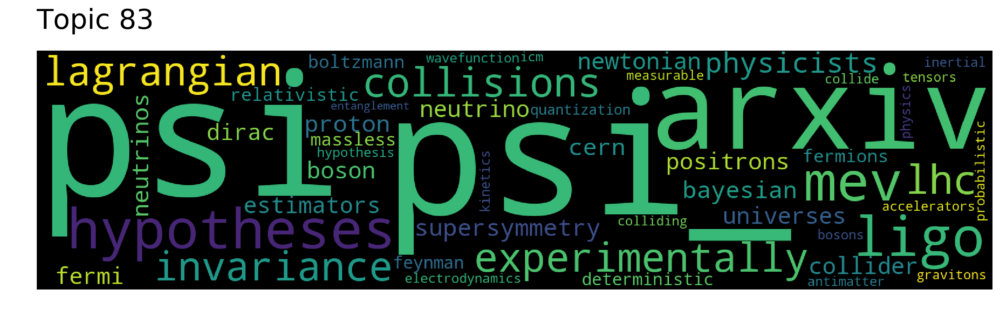

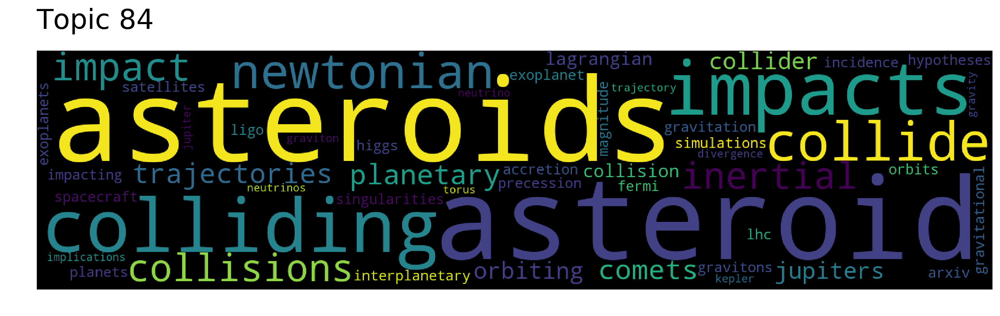

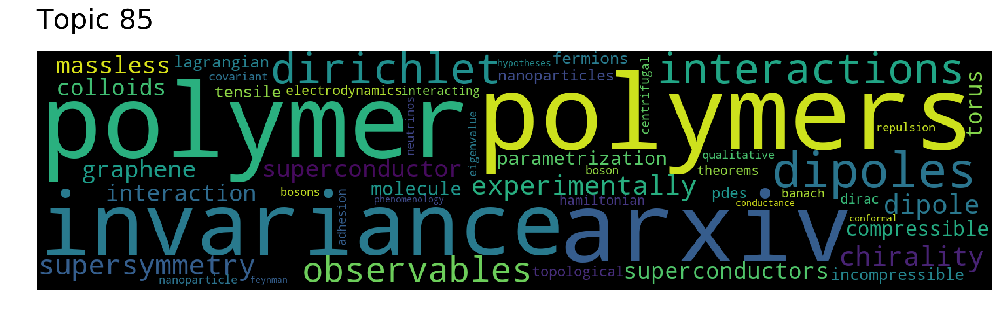

In [13]:
#generate wordclouds
#can be slow, so maybe don't run for all topics if you have a lot of topics
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

In [14]:
#print out example documents for a given topic
topic_num = 0
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_num, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 25650, Score: 0.8667690753936768
-----------
Electric dipole radiation can be controlled by coherent optical feedback, as has previously been studied by modulating the photonic environment for point dipoles placed both in optical cavities and near metal mirrors. In experiments involving fluorescent molecules, trapped ions and quantum dots the point nature of the dipole, its sub-unity quantum efficiency, and decoherence rate conspire to severely limit any change in total linewidth. Here we show that the transverse coherence of exciton emission in the monolayer two-dimensional (2D) material MoSe${}_2$ removes many of the fundamental physical limitations present in previous experiments. The coherent interaction between excitons and a photonic mode localized between the MoSe${}_2$ and a nearby planar mirror depends interferometrically on mirror position, enabling full control over the radiative coupling rate from near-zero to 1.8 meV and a corresponding change in exciton total li

# 2D projection

In [15]:
um = umap.UMAP()

In [16]:
doc_vecs_2d = um.fit_transform(model.document_vectors)

In [17]:
df['umap0'] = doc_vecs_2d[:,0]
df['umap1'] = doc_vecs_2d[:,1]

In [18]:
df['wrapped_text'] = df[text_col].str.wrap(100)
df['wrapped_text'] = df['wrapped_text'].apply(lambda x: x.replace('\n', '<br>'))

In [ ]:
layout1 = cufflinks.Layout(
    height=500,
    width=500,
    hovermode='closest'
)


df.iplot(
    x='umap0',
    categories='topic',
    y='umap1', mode='markers', 
    text='wrapped_text',
    layout = layout1)